# - Prototipo de Red Neural para la Predicción de la Demanda en el Sector del Retail -
### PROYECTO FINAL DE DEEP LEARNING 

### Integrantes
- Jhon Moreno Triviño
- Carlos Santiago Oliveros Morales
- Juan Manuel Sáenz


### Contexto
La Comercializadora M&D es una empresa que pertenece al sector del Retail cuyo nicho de negocio está enfocado a la venta directa por catálogo de productos de belleza, el hogar y sector textil, a través de canales físicos como digitales. Este es un negocio que ha reportado un crecimiento del 14.5% con respecto al último año en el país, lo cual representa una oportunidad para las cerca de 28 empresas reconocidas en Colombia de implementar estrategias para posicionarse como líderes en ventas de productos al por menor.  Para lograr mejores rendimientos, en la industria se han identificado algunos impulsores y dinámicas susceptibles a ser analizadas y optimizadas a través de modelos de aprendizaje de máquina y profundo, donde una de sus problemáticas principales es la mejora en la administración de su inventario, incluyendo la rotación de los productos para garantizar la disponibilidad según la demanda de los clientes.

Pese a que esta industria ya ha identificado la importancia de incluir procesos de analítica y aprendizaje automatizado a sus procesos de negocio, la Comercializadora M&D solo cuenta con un equipo de analistas de negocio que manualmente predicen las ventas y los pedidos campaña tras campaña, basado en su propia experiencia y conocimiento del negocio. Esto ha llevado a que la empresa presente en la actualidad, tasas de acierto del 40% en su predicción de la demanda para los productos mejor caracterizados. Para la otra mitad que no se encuentran caracterizados al mismo nivel, este rendimiento es incluso inferior. Esta condición impacta de forma negativa la línea de producción, la gestión y rotación de inventarios y en consecuencia, en el cumplimiento en el despacho de todos los pedidos realizados por los clientes. Esto último, en contravía de la imagen y estrategia del negocio, ya que Comercializadora M&D se proyecta como una organización ágil y rentable, comprometida con la satisfacción de las necesidades de sus clientes.


### Objetivo
•	Desarrollar un prototipo basado en modelos de estimación de la demanda para los productos más importantes de la empresa con un rendimiento de predicción mayor al estado actual.


### 0. Importación de librerías

In [2]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
!pip install contractions
import nltk
nltk.download('all')

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip (22.0 MB)


[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package abc is already up-to-date!
[nltk_data]    | Downloading package alpino to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package alpino is already up-to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger is already up-
[nltk_data]    |       to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger_ru is already
[nltk_data]    |       up-to-date!
[nltk_data]    | Downloading package basque_grammars to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    | 

[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package mte_teip5 to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package mte_teip5 is already up-to-date!
[nltk_data]    | Downloading package mwa_ppdb to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package mwa_ppdb is already up-to-date!
[nltk_data]    | Downloading package names to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Downloading package nombank.1.0 to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package nombank.1.0 is already up-to-date!
[nltk_data]    | Downloading package nonbreaking_prefixes to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package nonbreaking_prefixes is already up-to-date!
[nltk_data]    | Downloading package nps_chat

[nltk_data]    |   Package universal_treebanks_v20 is already up-to-
[nltk_data]    |       date!
[nltk_data]    | Downloading package vader_lexicon to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package vader_lexicon is already up-to-date!
[nltk_data]    | Downloading package verbnet to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package verbnet is already up-to-date!
[nltk_data]    | Downloading package verbnet3 to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package verbnet3 is already up-to-date!
[nltk_data]    | Downloading package webtext to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package webtext is already up-to-date!
[nltk_data]    | Downloading package wmt15_eval to
[nltk_data]    |     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]    |   Package wmt15_eval is already up-to-date!
[nltk_data]    | Downloadin

True

In [3]:
!pip install keras-tuner

In [4]:
#Analisis profundo de datos
from pandas_profiling import ProfileReport

In [5]:
from keras.preprocessing.text import Tokenizer
from keras.utils import pad_sequences

In [6]:
#Entrenamiento del modelo
from sklearn.model_selection import train_test_split, GridSearchCV

In [7]:
import keras_tuner as kt

In [8]:
import io
import os
import re
import shutil
import string
import tensorflow as tf

#Visualización de datos
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from keras import Sequential
from keras.layers import Flatten, Dense, Embedding, GlobalAveragePooling1D
from keras.layers import TextVectorization
from keras.layers import Dense, Embedding, LSTM, SpatialDropout1D
from keras.callbacks import EarlyStopping

import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import six
import os
import os.path as osp
import math
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, LSTM
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error
from sklearn.model_selection import TimeSeriesSplit, RandomizedSearchCV
import plotly.graph_objects as go
from datetime import datetime
from statsmodels.tsa.api import ExponentialSmoothing
import statsmodels.api as sm
import pickle

from numpy.random import seed
seed(33)

### 1. Cargar la información

In [44]:
Data = pd.read_csv( 'analytic_units_requeried.csv' , sep="|"  )
Data

C:\Users\carlo\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (18,19,20,22,23,24,25,26,27,28,29,30,31,32,33,37) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,campania,anio,sec_campania,id_tira,producto,referencia,id_color,id_talla,categoria,marca,...,estado_corporativo,criterio_corporativo,venta_total,venta_facturada,venta_no_facturada,costo_total,margen_absoluto,margen_absoluto_facturado,despachado,pedidos
0,1812,2018,12,1,a77eetaaaen,a77eet,aaa,en,ROPA INTERIOR,FASHIONTRENDS,...,E,Top Corp,549714.00,549714.00,0.0,3673742.500,-3124028.500,-3124028.500,234.0,234.0
1,1812,2018,12,1,a77eetaaaeo,a77eet,aaa,eo,ROPA INTERIOR,FASHIONTRENDS,...,E,Top Corp,433429.00,354143.00,79286.0,4521766.500,-4088337.500,-4167623.500,288.0,288.0
2,1812,2018,12,1,a77eetaaaet,a77eet,aaa,et,ROPA INTERIOR,FASHIONTRENDS,...,E,Top Corp,309212.00,269569.00,39643.0,3359747.200,-3050535.200,-3090178.200,214.0,214.0
3,1812,2018,12,1,a77eetFaaaen,a77eetF,aaa,en,ROPA INTERIOR,FASHIONTRENDS,...,E,Top Corp,39643.00,39643.00,0.0,16011.091,23631.910,23631.910,1.0,1.0
4,1812,2018,12,1,a77eetFaaaeo,a77eetF,aaa,eo,ROPA INTERIOR,FASHIONTRENDS,...,E,Top Corp,118929.00,39643.00,79286.0,48033.273,70895.730,23631.910,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
272092,2118,2021,18,291,p47xoaa79d,p47xo,aa7,9d,MARKET PLACE,VITU,...,E,COMPRADO,220141.88,220141.88,0.0,108985.000,111156.875,111156.875,71.0,71.0
272093,2118,2021,18,291,p47xoaax9d,p47xo,aax,9d,MARKET PLACE,VITU,...,E,COMPRADO,220560.92,220560.92,0.0,108985.000,111575.920,111575.920,71.0,71.0
272094,2118,2021,18,291,p47xoaae9d,p47xo,aae,9d,MARKET PLACE,VITU,...,E,COMPRADO,77573.32,77573.32,0.0,38375.000,39198.320,39198.320,25.0,25.0
272095,2118,2021,18,291,p47xoaan9d,p47xo,aan,9d,MARKET PLACE,VITU,...,E,COMPRADO,154938.44,154938.44,0.0,76750.000,78188.440,78188.440,50.0,50.0


In [10]:
ProfileReport(Data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

De la revisión de las correlaciones se puede encontrar que para las variables de utilidad (margen absoluto) algunas de las variables con mayor de correlación son: talla, marca, categoría, nombre grupo, linea_negocio, grupo_negocio, referencias_paquete, promociones, criterio corporativo y necesariamente algunas variables de costos de venta y facturación.

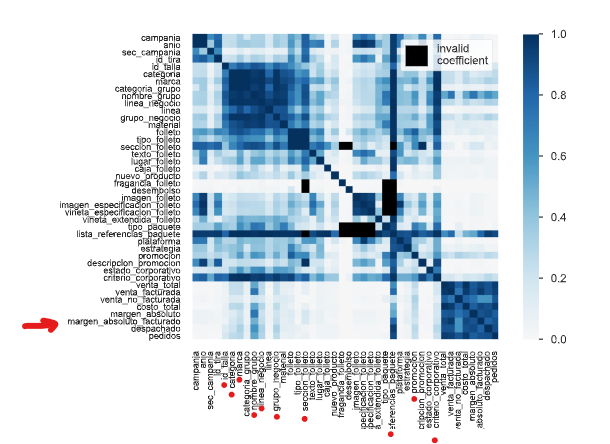

Adicionalmente, se cuenta con un diccionario de los datos del problema:

In [12]:
Dicc = pd.read_excel( 'DiccionarioDatosUnitsRequeried.xlsx'  )
Dicc

,VARIABLE,DESCRIPCION,TIPO DE DATO
0,campania,Identificador de la campaña,Numérico
1,anio,Año en que se lanza la campaña,Numérico
2,sec_campania,Consecutivo de la campaña dentro del año de la...,Numérico
3,id_tira,Identificador de la relación de productos sele...,Numérico
4,producto,Identificador del producto comercializado,Alfanumérico
5,referencia,Identificador de la referencia del producto,Alfanumérico
6,id_color,Identificador del color del producto,Alfanumérico
7,id_talla,Identificador de la talla del producto,Alfanumérico
8,categoria,Categoría a la que pertenece el producto,Alfanumérico
9,marca,Marca del producto,Alfanumérico


De la BD original se pueden realizar las siguientes observaciones:
- La BD cuenta con un número importante de variables (48) de distintos tipos: numéricas, categóricas y binarias.
- Se cuenta con 272.000 datos en la BD original.

A partir del perfilamiento de los datos se pueden realizar las siguientes observaciones:
- **Variable campaña:**
    * Presenta 60 instancias únicas. (60 campañas).
    * Su codificación numérica corresponde a un serial de 4 dígitos, que concatena el año y al consecutivo de la campaña de ese año.
    * Este valor teniendo en cuenta que ya se tienen, dos variables correspondientes al año y al sector se puede considerar en su **eliminación**.

- **Anio:**
    * Representa al año en el que se sacó la campaña de ventas.
    * Se tienen registros de 4 años, del 2018 al 2021.
    
- **Sec_campania:**
    * Cuenta con valores del 1 al 18, correspondientes al # de campaña, considerando una periodicidad de 3 semanas entre campaña.
    * Se evidencia que el # de instancias de las campañas 12 a 18 es mayor que las del resto del año (desde septiembre a diciembre). Lo anterior, puede deberse a la salida de un mayor número de productos para las campañas de fin de año, por las festividades.
   
- **Id_tira:**   
   * Presenta valores del 1 al 291, con un mayor número de instancias para los Id_tira menores a 50.
   * De acuerdo con el negocio, representa a un identificador de las referencias dentro de cada campaña. Sin que su codificación corresponda a un orden de catálogo o portafolio. Por lo anterior, se puede considerar en la **eliminación** de esta variable.

- **Producto:**
   * Presenta 39809 categorías únicas.
   * El mayor número de repeticiones por una categoría es de 60 veces, correspondientes a productos que se han sacado en todas las campañas registradas,
   * En la mayoría de los casos se tiene que el producto se sacó solamente para 1 campaña, y por lo tanto solo se tiene una instancia en la BD.
   * Está compuesto por la codificación de la referencia + el id del color + el id de la talla.
   * Dado que ya se tienen variables discretas en atributos distintos, se puede considerar **eliminar** este atributo de la BD.

- **Referencia:**
    * Presenta 5724 categorías unicas.
    * Prendas pueden tener la misma referencia pero distintos colores y tallas.
    * Se presentan 10 categorías con un numero significativo de elementos >1060. Sin embargo, la gran mayoría tienen pocas repeticiones (<100)
    
- **id_color:**
    * Se presentan 784 categorías únicas. 
    * La instancia con más repeticiones es maa con 44066 repeticiones en la BD, correspondiente al 16%  de los datos.
    * La segunda instancia es aaa con 27124 repeticiones, correpondiente al 10%.
    * Corresponde a una categoría del tipo de color de una referencia.
        
- **id_talla:**
    * Se presentan 30 categorías únicas.
    * 6 categorías corresponden a más del 60% de las repeticiones: RR, oa, Ra, oR, eo, en, et, ex, 9d y nR.
    * Corresponde a una categoría del tipo de talla de una referencia.
        
- **categoria:**
    * Presenta 9 categorías distintas.
    * Corresponde a una categoría de una clasificación macro del tipo de producto: ropa interior, activadores de demanda, vestidos de baño ...
    * La categoría ROPA INTERIOR representa el 55% de los datos.
    * Se tienen 141 elementos con campos vacíos.
        
- **marca:**
    * Presenta 58 instancias únicas.
    * Presenta alta cardinalidad y altas correlaciones. De modo que se puede seguir su trazabilidad en el ejercicio.
    * Se tienen 141 elementos con campos vacíos.
        
- **categoria_grupo:**
    * Presenta 4 categorías únicas.
    * La categoría MhQ representa al 55% de los elementos y abarca las categorías ROPA INTERIOR y SWIMWEAR. No existen referencias de categorías ROPA INTERIOR y SWIMWEAR que tenga una categoría_grupo distinta. 
    * Por lo anterior, se tendría información duplicada en ambos elementos. Se puede considerar su **eliminación** o la verificación de cuál variable describe mejor los resultados.
        
- **nombre_grupo:**
    * Presenta alta cardinalidad y correlación.
    * Presenta 77 categorías únicas.
    * Presenta 141 elementos con esta variable vacía.
    * Existen 3 nombres_grupo que representan el 50% de los datos: BRASIER, PANTALÓN Y CAMISETA.

- **linea_negocio:**
    * Presenta alta cardinalidad y correlación.
    * Presenta 72 categorías únicas.
    * Las categorías textiles, encajes y lisos representan el 50% de los datos.
    * Presentan 141 instancias con esta variable vacía.

- **linea:**
    * Presentan 141 instancias con esta variable vacía.
    * Presenta 22 categorías únicas.
    * Las categorías COMPLEMENTARIOS_EXP y UNIVERSAL representan el 78% de los datos. + Juvenil (10%) = 88%.
    * Son descripciones del tipo de producto.
    
- **grupo_negocio:**
    * Las categorías BASICO, MODA, REALCE y CONTROL represental al 60% de los datos.
    * Son descripciones del tipo de producto.
    * Presentan 141 instancias con esta variable vacía.
    * Presenta 46 categorías únicas.
    
- **material:**
    * Presentan 141 instancias con esta variable vacía.
    * Presenta 35 categorías únicas.
    * Las categorías TELA ELÁSTICA LISA, PUNTO, PLANO, LISO y ENCAJE representan el 70% de los datos.
    * Es una descripción adicional del producto.
    
- **folleto:**
    * Representa el medio por el cuál se realizó la compra.
    * Hay un desbalance marcado de las categorías de la variable.
    * La categoría CATÁLOGO abarca el 75% de los datos. 
    * Las gran mayoría de categorías no supera el 1%.
    * Existen 71 categorías únicas.
    
- **tipo_folleto:**
    * Presenta 10 categorías únicas.
    * Presenta un 5.5% de datos vacíos, correspondiente a 14957 datos.
    * Como se trata de una cantidad importante de números se puede revisar en mayor detalle si se pueden eliminar o si se debe tratar de otra forma.
    * La categoría PRIMARIO representa el 82% de los datos.
    
- **tipo_producto:**
    * Presenta un 35% de datos vacíos, correspondiente a 97770 datos.
    * Como son tantos datos se puede considerar en la **eliminación de la variable**.
    * Para los datos que si cuentan con información si se presenta una distribución más equilibrada de las categorías.
    * Presenta 1725 categorías.
    * Es una descripción adicional del producto.
    
- **seccion_folleto:**
    * Presenta un 98% de datos vacíos, correspondiente a 266280 datos. Esto es porque solo se diligencia para produtos vendidos a través de folletos, que no representan la mayoría de los elementos.
    * Como son tantos datos se recomienda en la **eliminación de la variable**.
    * Para los datos que si cuentan con información tampoco se presenta una distribución más equilibrada de las categorías.
    * Presenta 8 categorías, una con el 90% de los elementos.
    
- **texto_folleto:**
    * Corresponde a una categoría binaria.
    * Es una categoría relativamente equilibrada entre verdaderos y falsos.
    * Cuenta solo con 3 elementos con vacíos.
    
- **lugar_folleto:**
    * Presenta 6 valores únicos.
    * Presenta  el 20.4% de los elementos con esta información vacía.
    * Presenta alta cardinalidad y correlación.
    * Para los elementos que si se conocen se presenta una distribución sesgada en 2 categorías principales y 2 secundarias. Se debe revisar bien antes de realizar alguna eliminación.
        
- **caja_folleto:**
    * Variable binaria suprémamente sesgada, con el 99.8% de los elementos con clasificación verdadera.
    * Por lo anterior se puede considerar en la **eliminación** de esta variable.
        
- **nuevo_producto:**
    * Variable binaria suprémamente sesgada, con el 93% de los elementos con clasificación verdadera.
    * Por lo anterior se puede considerar en la **eliminación** de esta variable.
    * Además de acuerdo con el negocio, se busca construir un modelo que se base en una serie histórica de un producto existente. Esta variable solo aplica cuando se introduce un nuevo producto.
        
- **texto_educativo_folleto:**
    * Variable binaria suprémamente sesgada, con el 99.9% de los elementos con clasificación verdadera.
    * Por lo anterior se puede considerar en la **eliminación** de esta variable.
    
- **fragancia_folleto:**
    *  Variable binaria suprémamente sesgada, con el 99.9% de los elementos con clasificación verdadera.
    * Por lo anterior se puede considerar en la **eliminación** de esta variable.
    
- **desembolso:**
    *  Variable binaria suprémamente sesgada, con el 99.9% de los elementos con clasificación verdadera.
    * Por lo anterior se puede considerar en la **eliminación** de esta variable.
    
- **imagen_folleto:**
    * Categoría binaria con distribución sesgada pero aceptable.
    * Existen 3 valores vacíos que se repiten en elementos siguientes que se deberán procesar.
    
- **imagen_especificacion_folleto:**
    * Categoría binaria con distribución sesgada pero aceptable.
    * Existen 3 valores vacíos que se repiten en elementos siguientes que se deberán procesar.
    
- **vineta_especificacion_folleto:**
    * Categoría binaria con distribución sesgada pero aceptable.
    * Existen 3 valores vacíos que se repiten en elementos siguientes que se deberán procesar.

- **vineta_extendida_folleto:**
    * Categoría binaria con distribución sesgada pero aceptable.
    * Existen 3 valores vacíos que se repiten en elementos siguientes que se deberán procesar.

- **descripcion_paquete:**
    * Variable categórica suprémamente sesgada, con el +90% de los elementos faltantes.
    * Por lo anterior se puede considerar en la **eliminación** de esta variable.

- **tipo_paquete:**
    * Variable categórica suprémamente sesgada, con el +90% de los elementos faltantes.
    * Por lo anterior se puede considerar en la **eliminación** de esta variable.
    
- **lista_referencias_paquete:**
    * Variable categórica suprémamente sesgada, con el +90% de los elementos faltantes.
    * Por lo anterior se puede considerar en la **eliminación** de esta variable.
    
- **plataforma:**
    * Presenta un 20% de datos vacíos, correspondiente a 55524 datos.
    * Como son tantos datos se puede considerar en la **eliminación de la variable**, pero se debe revisar antes su importancia para los productos seleccionados.
    * Para los datos que si cuentan con información tampoco se presenta una distribución más equilibrada de las categorías.
    * Presenta 12 categorías, donde No Aplica representa al 53% de los datos.
    
- **estrategia:**
    * Presenta un 20% de datos vacíos, correspondiente a 55524 datos.
    * Como son tantos datos se puede considerar en la **eliminación de la variable**, pero se debe revisar antes su importancia para los productos seleccionados.
    * Para los datos que si cuentan con información tampoco se presenta una distribución más equilibrada de las categorías.
    * Presenta 12 categorías, donde No Aplica representa al 53% de los datos.
    
- **promocion:**
    * Presenta un 20% de datos vacíos, correspondiente a 55524 datos.
    * Como son tantos datos se puede considerar en la **eliminación de la variable**, pero se debe revisar antes su importancia para los productos seleccionados.
    * Para los datos que si cuentan con información tampoco se presenta una distribución más equilibrada de las categorías.
    * Presenta 12 categorías, donde No Aplica representa al 53% de los datos.
    
- **descripcion_promocion:**
    * Corresponde a una categoría binaria.
    * Es una categoría relativamente equilibrada entre verdaderos y falsos.
    * Cuenta solo con 3 elementos con vacíos.
    
- **estado_corporativo:**
    * Presenta 7 clasificaciones únicas.
    * Es una categoría relativamente bastante sesgada donde el 83% de los datos presentan valores.
    * Cuenta con 321 elementos con vacíos.
    
- **criterio_corporativo:**
    * Presenta 88 clasificaciones únicas.
    * Es una categoría relativamente bastante equilibrada.
    * No cuenta con elementos con vacíos.

Las variables numéricas de ventas, producción y margenes se revisarán de acuerdo a los productos seleccionados.

- **venta_total**     
- **venta_facturada**  
- **venta_no_facturada**
- **costo_total**
- **margen_absoluto**
- **margen_absoluto_facturado**
- **despachado**
- **pedidos**    

Ahora, se identificarán los productos que representan en mayor medida las utilidades de la empresa. Cómo métricas de importancia de revisarán distintas métricas:

- A partir de ventas totales:

In [52]:
ReferenciasUnicas = Data.producto.unique()
print(ReferenciasUnicas)
print( len(ReferenciasUnicas)  )

['a77eetaaaen' 'a77eetaaaeo' 'a77eetaaaet' ... 'pYxetteRet' 'pYxetteRna'
 'pYxetteRnx']
39809


In [53]:
VentasTotales = []
VentasPromedioCampania = []

for ii in range( len(ReferenciasUnicas) ):
    
    BD_ii = Data[Data['producto'] == ReferenciasUnicas[ii]]
    
    VentasTotales.append( BD_ii['venta_total'].sum() )
    VentasPromedioCampania.append( BD_ii['venta_total'].sum()/BD_ii.shape[0] )   
        

In [54]:
BD_Ventas = pd.DataFrame( ReferenciasUnicas , columns = ['Producto'])
BD_Ventas['Ventas_Totales'] = VentasTotales
BD_Ventas['Ventas_Promedio'] = VentasPromedioCampania

In [55]:
BD_Ventas

,Producto,Ventas_Totales,Ventas_Promedio
0,a77eetaaaen,4.758780e+08,8.348737e+06
1,a77eetaaaeo,5.755486e+08,1.009734e+07
2,a77eetaaaet,4.019677e+08,7.052064e+06
3,a77eetFaaaen,1.572110e+07,1.209315e+06
4,a77eetFaaaeo,1.948465e+07,1.623721e+06
...,...,...,...
39804,pYxetteRen,1.723275e+06,1.723275e+06
39805,pYxetteReo,1.117478e+06,1.117478e+06
39806,pYxetteRet,5.675648e+05,5.675648e+05
39807,pYxetteRna,5.587408e+05,5.587408e+05


    Visto en términos de las ventas totales:

In [58]:
BD_Ventas.sort_values(by=['Ventas_Totales'] , ascending=False).head()

,Producto,Ventas_Totales,Ventas_Promedio
2132,7xooGveGG7RR,2.687559e+09,4.555185e+07
270,a77tn7taxen,2.378660e+09,3.964434e+07
21009,a7xGmatRmRR,2.290577e+09,7.898540e+07
1417,a7xGa7maaRR,2.025686e+09,3.376144e+07
2124,7xoenveGtnRR,1.998232e+09,3.330387e+07


    Visto en términos de las ventas promedio por campaña:

In [59]:
BD_Ventas.sort_values(by=['Ventas_Promedio'] , ascending=False).head()

,Producto,Ventas_Totales,Ventas_Promedio
28276,AnnoenR7m9d,859761000.0,859761000.0
39032,AnnRGG7xm9d,818144830.0,818144830.0
36770,AnnotRe7t9d,785246140.0,785246140.0
23868,AnnRGt7nRoa,429170530.0,429170530.0
25834,AnnRGmxmo9d,346866660.0,346866660.0


Ahora, se realiza una comparación porcentual:

In [63]:
VentasTotales / BD_Ventas['Ventas_Totales'].sum()

array([2.88096513e-04, 3.48437091e-04, 2.43351179e-04, ...,
       3.43603647e-07, 3.38261598e-07, 2.08297948e-07])

In [70]:
BD_Ventas['Ventas_Tot_Rel'] = 100*BD_Ventas['Ventas_Totales']/BD_Ventas['Ventas_Totales'].sum()
BD_Ventas['Ventas_Prom_Rel'] = 100*BD_Ventas['Ventas_Promedio']/BD_Ventas['Ventas_Promedio'].max()
BD_Ventas.head()

,Producto,Ventas_Totales,Ventas_Promedio,Ventas_Tot_Rel,Ventas_Prom_Rel
0,a77eetaaaen,475878027.5,8.348737e+06,0.028810,0.971053
1,a77eetaaaeo,575548636.5,1.009734e+07,0.034844,1.174436
2,a77eetaaaet,401967652.0,7.052064e+06,0.024335,0.820235
3,a77eetFaaaen,15721095.0,1.209315e+06,0.000952,0.140657
4,a77eetFaaaeo,19484647.8,1.623721e+06,0.001180,0.188857


In [71]:
BD_Ventas.sort_values(by=['Ventas_Tot_Rel'] , ascending=False).head()

,Producto,Ventas_Totales,Ventas_Promedio,Ventas_Tot_Rel,Ventas_Prom_Rel
2132,7xooGveGG7RR,2.687559e+09,4.555185e+07,0.162705,5.298200
270,a77tn7taxen,2.378660e+09,3.964434e+07,0.144004,4.611088
21009,a7xGmatRmRR,2.290577e+09,7.898540e+07,0.138671,9.186903
1417,a7xGa7maaRR,2.025686e+09,3.376144e+07,0.122635,3.926840
2124,7xoenveGtnRR,1.998232e+09,3.330387e+07,0.120973,3.873620


In [72]:
BD_Ventas.sort_values(by=['Ventas_Prom_Rel'] , ascending=False).head()

,Producto,Ventas_Totales,Ventas_Promedio,Ventas_Tot_Rel,Ventas_Prom_Rel
28276,AnnoenR7m9d,859761000.0,859761000.0,0.052050,100.000000
39032,AnnRGG7xm9d,818144830.0,818144830.0,0.049530,95.159565
36770,AnnotRe7t9d,785246140.0,785246140.0,0.047539,91.333073
23868,AnnRGt7nRoa,429170530.0,429170530.0,0.025982,49.917422
25834,AnnRGmxmo9d,346866660.0,346866660.0,0.020999,40.344545


Ahora, se realiza el mismo ejercicio con respecto a su MARGEN (utilidad).

- A partir de margen absoluto:

In [73]:
MargenTotales = []
MargenPromedioCampania = []

for ii in range( len(ReferenciasUnicas) ):
    
    BD_ii = Data[Data['producto'] == ReferenciasUnicas[ii]]
    
    MargenTotales.append( BD_ii['margen_absoluto'].sum() )
    MargenPromedioCampania.append( BD_ii['margen_absoluto'].sum()/BD_ii.shape[0] )   
    
BD_Margen = pd.DataFrame( ReferenciasUnicas , columns = ['Producto'])
BD_Margen['Margen_Totales'] = MargenTotales
BD_Margen['Margen_Promedio'] = MargenPromedioCampania

BD_Margen['Margen_Tot_Rel'] = 100*BD_Margen['Margen_Totales']/BD_Margen['Margen_Totales'].sum()
BD_Margen['Margen_Prom_Rel'] = 100*BD_Margen['Margen_Promedio']/BD_Margen['Margen_Promedio'].max()
BD_Margen.head()

,Producto,Margen_Totales,Margen_Promedio,Margen_Tot_Rel,Margen_Prom_Rel
0,a77eetaaaen,2.643822e+08,4.638285e+06,0.029706,1.530972
1,a77eetaaaeo,3.195772e+08,5.606617e+06,0.035907,1.850592
2,a77eetaaaet,2.215886e+08,3.887519e+06,0.024898,1.283164
3,a77eetFaaaen,9.151432e+06,7.039563e+05,0.001028,0.232357
4,a77eetFaaaeo,1.135676e+07,9.463966e+05,0.001276,0.312380


    Visto en términos de las margenes totales:

In [76]:
BD_Margen.sort_values(by=['Margen_Totales'] , ascending=False).head()

,Producto,Margen_Totales,Margen_Promedio,Margen_Tot_Rel,Margen_Prom_Rel
21009,a7xGmatRmRR,1.585625e+09,5.467672e+07,0.178160,18.047297
270,a77tn7taxen,1.426739e+09,2.377898e+07,0.160307,7.848794
1417,a7xGa7maaRR,1.103847e+09,1.839745e+07,0.124027,6.072499
2362,xamveGtnRR,1.096999e+09,1.828331e+07,0.123258,6.034824
2132,7xooGveGG7RR,1.093618e+09,1.853589e+07,0.122878,6.118195


    Visto en términos de las margenes promedio por campaña:

In [77]:
BD_Margen.sort_values(by=['Margen_Promedio'] , ascending=False).head()

,Producto,Margen_Totales,Margen_Promedio,Margen_Tot_Rel,Margen_Prom_Rel
28276,AnnoenR7m9d,302963460.0,302963460.0,0.034041,100.000000
39032,AnnRGG7xm9d,253664960.0,253664960.0,0.028502,83.727906
36770,AnnotRe7t9d,215518110.0,215518110.0,0.024215,71.136668
28971,AnnoeRGGtRR,192202110.0,192202110.0,0.021596,63.440690
31519,mxea7LnGGGRR,151407650.0,151407650.0,0.017012,49.975548


Se considera como criterio **más importante** la lista por margen en términos totales, la cual resulta en los próductos con presencia constante en todas las campañas registradas y de los cuales se tiene más información.

### 2. Preparación de la información

In [45]:
Data = Data.drop_duplicates() # Se eliminan duplicados exactos

#Data = Data.drop(['campania'], axis=1)
Data = Data.drop(['id_tira'], axis=1)
#Data = Data.drop(['producto'], axis=1)

Data = Data.drop(['seccion_folleto'], axis=1)
Data = Data.drop(['caja_folleto'], axis=1)
Data = Data.drop(['nuevo_producto'], axis=1)

Data = Data.drop(['texto_educativo_folleto'], axis=1)
Data = Data.drop(['fragancia_folleto'], axis=1)
Data = Data.drop(['desembolso'], axis=1)

Data = Data.drop(['descripcion_paquete'], axis=1)
Data = Data.drop(['tipo_paquete'], axis=1)
Data = Data.drop(['lista_referencias_paquete'], axis=1)

In [ ]:
#Data['categoria'].replace('', np.nan, inplace=True)
#Data.dropna(subset=['categoria'], inplace=True)

#Data['marca'].replace('', np.nan, inplace=True)
#Data.dropna(subset=['marca'], inplace=True)

In [46]:
Data

,campania,anio,sec_campania,producto,referencia,id_color,id_talla,categoria,marca,categoria_grupo,...,estado_corporativo,criterio_corporativo,venta_total,venta_facturada,venta_no_facturada,costo_total,margen_absoluto,margen_absoluto_facturado,despachado,pedidos
0,1812,2018,12,a77eetaaaen,a77eet,aaa,en,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,549714.00,549714.00,0.0,3673742.500,-3124028.500,-3124028.500,234.0,234.0
1,1812,2018,12,a77eetaaaeo,a77eet,aaa,eo,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,433429.00,354143.00,79286.0,4521766.500,-4088337.500,-4167623.500,288.0,288.0
2,1812,2018,12,a77eetaaaet,a77eet,aaa,et,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,309212.00,269569.00,39643.0,3359747.200,-3050535.200,-3090178.200,214.0,214.0
3,1812,2018,12,a77eetFaaaen,a77eetF,aaa,en,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,39643.00,39643.00,0.0,16011.091,23631.910,23631.910,1.0,1.0
4,1812,2018,12,a77eetFaaaeo,a77eetF,aaa,eo,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,118929.00,39643.00,79286.0,48033.273,70895.730,23631.910,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
272092,2118,2021,18,p47xoaa79d,p47xo,aa7,9d,MARKET PLACE,VITU,dy1T,...,E,COMPRADO,220141.88,220141.88,0.0,108985.000,111156.875,111156.875,71.0,71.0
272093,2118,2021,18,p47xoaax9d,p47xo,aax,9d,MARKET PLACE,VITU,dy1T,...,E,COMPRADO,220560.92,220560.92,0.0,108985.000,111575.920,111575.920,71.0,71.0
272094,2118,2021,18,p47xoaae9d,p47xo,aae,9d,MARKET PLACE,VITU,dy1T,...,E,COMPRADO,77573.32,77573.32,0.0,38375.000,39198.320,39198.320,25.0,25.0
272095,2118,2021,18,p47xoaan9d,p47xo,aan,9d,MARKET PLACE,VITU,dy1T,...,E,COMPRADO,154938.44,154938.44,0.0,76750.000,78188.440,78188.440,50.0,50.0


Ahora, se realiza el filtro de los productos selecionados.

In [47]:
#ReferenciasOrganizadas = BD_Margen.sort_values(by=['Margen_Totales'] , ascending=False).producto[0:3]
#ReferenciasOrganizadas = ['a7xGmatRmRR','a77tn7taxen','a7xGa7maaRR']
ReferenciasOrganizadas = ['a77tn7taxen','a7xGa7maaRR' , 'xamveGtnRR']
#ReferenciasOrganizadas = ['AnnoenR7m9d','AnnRGG7xm9d']
ReferenciasOrganizadas

['a77tn7taxen', 'a7xGa7maaRR', 'xamveGtnRR']

In [49]:
frames = []

for ii in range( len(ReferenciasOrganizadas) ):
    df_ii =  Data[Data['producto'] == ReferenciasOrganizadas[ii] ]
    frames.append( df_ii )
frames

Data_filter = pd.concat(frames)
Data_filter

,campania,anio,sec_campania,producto,referencia,id_color,id_talla,categoria,marca,categoria_grupo,...,estado_corporativo,criterio_corporativo,venta_total,venta_facturada,venta_no_facturada,costo_total,margen_absoluto,margen_absoluto_facturado,despachado,pedidos
270,1812,2018,12,a77tn7taxen,a77tn7,tax,en,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,22422120.0,22422120.0,0.00,6887356.0,15534764.0,15534764.0,395.0,395.0
4688,1813,2018,13,a77tn7taxen,a77tn7,tax,en,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,20303772.0,20303772.0,0.00,7179454.0,13124318.0,13124318.0,412.0,412.0
9042,1814,2018,14,a77tn7taxen,a77tn7,tax,en,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,25412240.0,25412240.0,0.00,6482419.5,18929820.0,18929820.0,372.0,372.0
13217,1815,2018,15,a77tn7taxen,a77tn7,tax,en,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,27645808.0,27548452.0,97355.00,9723630.0,17922178.0,17859674.0,556.0,558.0
17790,1816,2018,16,a77tn7taxen,a77tn7,tax,en,ROPA INTERIOR,FASHIONTRENDS,MhQ,...,E,Top Corp,37982336.0,33685228.0,4297106.00,13694453.0,24287884.0,21532064.0,686.0,773.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251508,2114,2021,14,xamveGtnRR,xamve,Gtn,RR,ROPA INTERIOR,PAQUETERIA FASHIONTRENDS,MhQ,...,E,PAQUETE,26899754.0,26899754.0,0.00,9268943.0,17630810.0,17630810.0,803.0,803.0
255692,2115,2021,15,xamveGtnRR,xamve,Gtn,RR,ROPA INTERIOR,PAQUETERIA FASHIONTRENDS,MhQ,...,E,PAQUETE,31799686.0,31736168.0,63518.00,11125268.0,20674418.0,20634322.0,948.0,950.0
259971,2116,2021,16,xamveGtnRR,xamve,Gtn,RR,ROPA INTERIOR,PAQUETERIA FASHIONTRENDS,MhQ,...,E,PAQUETE,18867038.0,18631114.0,235922.84,6640534.5,12226503.0,12072562.0,558.0,565.0
264210,2117,2021,17,xamveGtnRR,xamve,Gtn,RR,ROPA INTERIOR,PAQUETERIA FASHIONTRENDS,MhQ,...,E,PAQUETE,25275532.0,25275532.0,0.00,8821229.0,16454302.0,16454302.0,761.0,761.0


**Importante :** Se puede evidenciar que los 3 productos seleccionados tienen 60 campañas registradas en total.

Representación gráfica de las series:

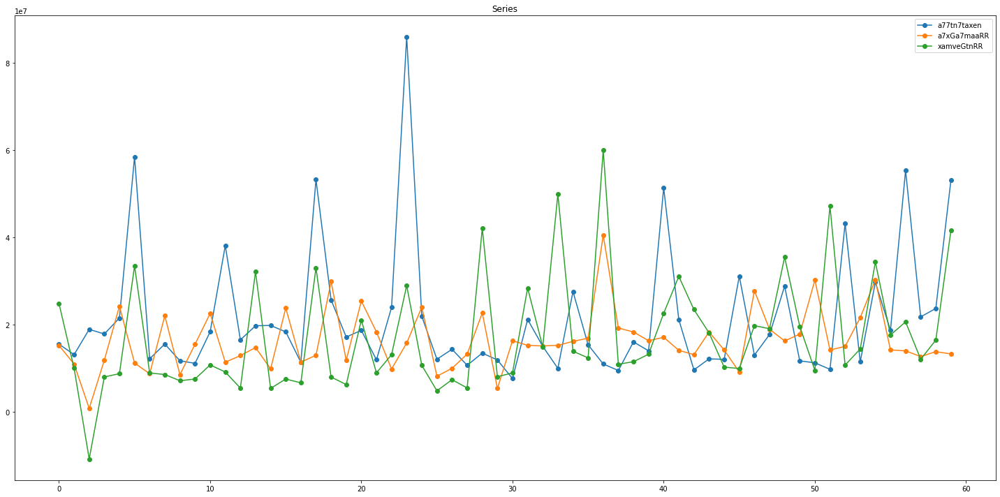

In [50]:
%matplotlib inline
fig, axs = plt.subplots(1,figsize=(20,10))

for ii in range( len(ReferenciasOrganizadas) ):
    
    df_ii =  Data[Data['producto'] == ReferenciasOrganizadas[ii] ]
    xvals = list(range( df_ii.shape[0] ))
    axs.plot(xvals, df_ii.margen_absoluto_facturado ,'o-', label = ReferenciasOrganizadas[ii] )
    

axs.set(title='Series')
axs.legend()

plt.tight_layout()
plt.show()    

Se revisa ahora, el estado de las variables una vez realizado el filtro de los productos de análisis.

In [51]:
ProfileReport(Data_filter)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

A partir de los resultados anteriores se pueden eliminar los siguientes datos, que no aportan o son constantes para los productos y  por tanto no harían diferencias en la red:

In [52]:
Data_filter = Data_filter.drop(['marca'], axis=1)
Data_filter = Data_filter.drop(['categoria_grupo'], axis=1)
Data_filter = Data_filter.drop(['categoria'], axis=1)
Data_filter = Data_filter.drop(['producto'], axis=1)
Data_filter = Data_filter.drop(['referencia'], axis=1)
Data_filter = Data_filter.drop(['id_color'], axis=1)
Data_filter = Data_filter.drop(['id_talla'], axis=1)
Data_filter = Data_filter.drop(['nombre_grupo'], axis=1)
Data_filter = Data_filter.drop(['linea_negocio'], axis=1)
Data_filter = Data_filter.drop(['linea'], axis=1)
Data_filter = Data_filter.drop(['grupo_negocio'], axis=1)
Data_filter = Data_filter.drop(['material'], axis=1)
Data_filter = Data_filter.drop(['folleto'], axis=1)
Data_filter = Data_filter.drop(['tipo_folleto'], axis=1)
Data_filter = Data_filter.drop(['tipo_producto'], axis=1)
Data_filter = Data_filter.drop(['estado_corporativo'], axis=1)
Data_filter

,campania,anio,sec_campania,texto_folleto,lugar_folleto,imagen_folleto,imagen_especificacion_folleto,vineta_especificacion_folleto,vineta_extendida_folleto,plataforma,...,estado_corporativo,criterio_corporativo,venta_total,venta_facturada,venta_no_facturada,costo_total,margen_absoluto,margen_absoluto_facturado,despachado,pedidos
270,1812,2018,12,True,NaN,True,True,True,True,NaN,...,E,Top Corp,22422120.0,22422120.0,0.00,6887356.0,15534764.0,15534764.0,395.0,395.0
4688,1813,2018,13,True,NaN,True,True,True,True,NaN,...,E,Top Corp,20303772.0,20303772.0,0.00,7179454.0,13124318.0,13124318.0,412.0,412.0
9042,1814,2018,14,True,NaN,True,True,True,True,NaN,...,E,Top Corp,25412240.0,25412240.0,0.00,6482419.5,18929820.0,18929820.0,372.0,372.0
13217,1815,2018,15,True,NaN,True,True,True,True,NaN,...,E,Top Corp,27645808.0,27548452.0,97355.00,9723630.0,17922178.0,17859674.0,556.0,558.0
17790,1816,2018,16,True,NaN,True,True,True,True,NaN,...,E,Top Corp,37982336.0,33685228.0,4297106.00,13694453.0,24287884.0,21532064.0,686.0,773.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251508,2114,2021,14,False,Media página,False,False,False,False,No Aplica,...,E,PAQUETE,26899754.0,26899754.0,0.00,9268943.0,17630810.0,17630810.0,803.0,803.0
255692,2115,2021,15,False,Página,False,False,False,False,No Aplica,...,E,PAQUETE,31799686.0,31736168.0,63518.00,11125268.0,20674418.0,20634322.0,948.0,950.0
259971,2116,2021,16,False,Media página,False,False,False,False,Plataforma inicial,...,E,PAQUETE,18867038.0,18631114.0,235922.84,6640534.5,12226503.0,12072562.0,558.0,565.0
264210,2117,2021,17,False,Media página,False,False,False,False,Plataforma final,...,E,PAQUETE,25275532.0,25275532.0,0.00,8821229.0,16454302.0,16454302.0,761.0,761.0


La variable objetivo de la empresa es el # de **pedidos** para saber cuanto esperar en producción y preveer los insumos.

In [54]:
Data_filter = Data_filter.drop(['venta_total'], axis=1)
Data_filter = Data_filter.drop(['venta_facturada'], axis=1)
Data_filter = Data_filter.drop(['venta_no_facturada'], axis=1)
Data_filter = Data_filter.drop(['costo_total'], axis=1)
Data_filter = Data_filter.drop(['margen_absoluto'], axis=1)
Data_filter = Data_filter.drop(['margen_absoluto_facturado'], axis=1)
Data_filter = Data_filter.drop(['despachado'], axis=1)
Data_filter

,campania,anio,sec_campania,texto_folleto,lugar_folleto,imagen_folleto,imagen_especificacion_folleto,vineta_especificacion_folleto,vineta_extendida_folleto,plataforma,estrategia,promocion,descripcion_promocion,criterio_corporativo,pedidos
270,1812,2018,12,True,NaN,True,True,True,True,NaN,NaN,NaN,True,Top Corp,395.0
4688,1813,2018,13,True,NaN,True,True,True,True,NaN,NaN,NaN,True,Top Corp,412.0
9042,1814,2018,14,True,NaN,True,True,True,True,NaN,NaN,NaN,True,Top Corp,372.0
13217,1815,2018,15,True,NaN,True,True,True,True,NaN,NaN,NaN,True,Top Corp,558.0
17790,1816,2018,16,True,NaN,True,True,True,True,NaN,NaN,NaN,True,Top Corp,773.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251508,2114,2021,14,False,Media página,False,False,False,False,No Aplica,No Aplica,Regular,False,PAQUETE,803.0
255692,2115,2021,15,False,Página,False,False,False,False,No Aplica,No Aplica,Regular,False,PAQUETE,950.0
259971,2116,2021,16,False,Media página,False,False,False,False,Plataforma inicial,Power,Regular,False,PAQUETE,565.0
264210,2117,2021,17,False,Media página,False,False,False,False,Plataforma final,Power,Regular,False,PAQUETE,761.0


Se identificó que en la variable "criterio_corporativo" existe unas categorias que se pueden corregir:

In [55]:
Data_filter['criterio_corporativo'].replace('PAQUETE', 'Paquete', inplace=True)
Data_filter['criterio_corporativo'].replace('TOP CORP', 'Top Corp', inplace=True)

De acuerdo con expertos de la empresa se identificó también que:

In [77]:
Data_filter['promocion'].replace('', 'Regular', inplace=True)
Data_filter['promocion'].replace(np.nan, 'Regular', inplace=True)
Data_filter['promocion'].replace('Por solo $', 'Promo', inplace=True)
Data_filter['promocion'].replace('Oferta Vive', 'Promo', inplace=True)
Data_filter['promocion'].replace('Imperdible', 'Promo', inplace=True)
Data_filter['promocion'].replace('Super Oferta', 'Promo', inplace=True)
Data_filter['promocion'].replace('Super oferta', 'Promo', inplace=True)
Data_filter['promocion'].replace('Uno mas', 'Promo', inplace=True)
Data_filter['promocion'].replace('Uno más', 'Promo', inplace=True)

In [67]:
Data_filter['plataforma'].replace('', 'No Aplica', inplace=True)
Data_filter['plataforma'].replace(np.nan, 'No Aplica', inplace=True)
Data_filter['estrategia'].replace('', 'No Aplica', inplace=True)
Data_filter['estrategia'].replace(np.nan, 'No Aplica', inplace=True)

In [69]:
Data_filter['lugar_folleto'].replace('', 'No Registrado', inplace=True)
Data_filter['lugar_folleto'].replace(np.nan, 'No Registrado', inplace=True)
Data_filter['lugar_folleto'].replace('Por definir', 'No Registrado', inplace=True)

In [74]:
Data_filter

,campania,anio,sec_campania,texto_folleto,lugar_folleto,imagen_folleto,imagen_especificacion_folleto,vineta_especificacion_folleto,vineta_extendida_folleto,plataforma,estrategia,promocion,descripcion_promocion,criterio_corporativo,pedidos
270,1812,2018,12,True,No Registrado,True,True,True,True,No Aplica,No Aplica,Regular,True,Top Corp,395.0
4688,1813,2018,13,True,No Registrado,True,True,True,True,No Aplica,No Aplica,Regular,True,Top Corp,412.0
9042,1814,2018,14,True,No Registrado,True,True,True,True,No Aplica,No Aplica,Regular,True,Top Corp,372.0
13217,1815,2018,15,True,No Registrado,True,True,True,True,No Aplica,No Aplica,Regular,True,Top Corp,558.0
17790,1816,2018,16,True,No Registrado,True,True,True,True,No Aplica,No Aplica,Regular,True,Top Corp,773.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251508,2114,2021,14,False,Media página,False,False,False,False,No Aplica,No Aplica,Regular,False,Paquete,803.0
255692,2115,2021,15,False,Página,False,False,False,False,No Aplica,No Aplica,Regular,False,Paquete,950.0
259971,2116,2021,16,False,Media página,False,False,False,False,Plataforma inicial,Power,Regular,False,Paquete,565.0
264210,2117,2021,17,False,Media página,False,False,False,False,Plataforma final,Power,Regular,False,Paquete,761.0


In [78]:
ProfileReport(Data_filter)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Una vez verificado que la BD está limpia, se procede a agregar campos a las series de datos correspondientes a información de contexto de las campañas en las que salieron.